In [5]:
from logger import setup_logger
from config import setup_kaggle_credentials
from data_utils import download_dataset, load_data_files_to_dataframes

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

import pandas as pd
import numpy as np

from scipy import stats

#suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [6]:
# Setup logger
logger = setup_logger()

# Get Credentials
username, api_key = setup_kaggle_credentials(logger)

2025-09-09 17:42:53,708 - INFO - Logger initialized
2025-09-09 17:42:53,709 - INFO - Setting up Kaggle credentials from environment variables...
2025-09-09 17:42:53,710 - INFO - ✅ Successfully loaded Kaggle credentials from environment variables


In [7]:
dataset_path = download_dataset(logger, "ethon0426/lending-club-20072020q1")
dataframes = load_data_files_to_dataframes(logger, dataset_path)

2025-09-09 17:42:55,045 - INFO - ⬇️ Downloading dataset: ethon0426/lending-club-20072020q1
2025-09-09 17:42:55,362 - INFO - ✅ Dataset downloaded to: /Users/rashmi/.cache/kagglehub/datasets/ethon0426/lending-club-20072020q1/versions/3
2025-09-09 17:42:55,363 - INFO - �� Loading data files from: /Users/rashmi/.cache/kagglehub/datasets/ethon0426/lending-club-20072020q1/versions/3
2025-09-09 17:42:55,364 - INFO - Loading file: Loan_status_2007-2020Q3.gzip
2025-09-09 17:43:23,373 - INFO - ✅ Loaded Loan_status_2007-2020Q3.gzip as CSV with name Loan_status_2007-2020Q3.gzip: 2925493 rows, 142 columns
2025-09-09 17:43:23,377 - INFO - ✅ Successfully loaded 1 data files


In [ ]:
loan_df = dataframes["Loan_status_2007-2020Q3.gzip"].copy() 

In [32]:
# df = loan_df.sample(1000000)
df = loan_df.copy()

### Data Engineering

In [33]:
# Drop rows with no term
df = df[df['term'].notna()] #drops 1 row

# Fico Score as the average of the range of low and high fico scores
fico_score_low = df['fico_range_low']
fico_score_high = df['fico_range_high']
fico_score_mean = (fico_score_low + fico_score_high) / 2
df['fico_score'] = fico_score_mean

# FICO Score Category
df['fico_category'] = pd.cut(df['fico_score'], 
                          bins=[600, 650, 700, 750, 800, 850],
                          labels=['Poor', 'Fair', 'Good', 'Very Good', 'Excellent'],
                          ordered=True)

# Risk Segment
df['fico_score_risk_segment'] = pd.cut(df['fico_score'], 
                         bins=[600, 650, 700, 750, 800, 850], 
                         labels=['High', 'Medium', 'Low', 'Good', 'Prime'],
                         ordered=True)

# Subprime
df['is_subprime'] = (df['fico_score'] < 670).astype(int)

# Issue Date
df['issue_d'] = pd.to_datetime(df['issue_d'])

# Cohort
df['cohort'] = df['issue_d'].dt.to_period('Y').astype(str)

# ROI
df['roi'] = (df['total_pymnt'] - df['loan_amnt']) / df['loan_amnt']

# ROI including all income sources
df['comprehensive_roi'] = (
    df['total_rec_int'] +  #total interest received to date
    df['total_rec_late_fee'] +  #total late fees received to date
    df['collection_recovery_fee'] + #collection recovery fee (if any)
    (df['total_rec_prncp'] - df['loan_amnt']) #principal received to date
) / df['loan_amnt']

# Gross Revenue
df['gross_revenue'] = df['total_rec_late_fee'] + df['total_rec_int'] + df['collection_recovery_fee']

# Term 
df['term'] = df['term'].str.replace(' months', '')
df['term'] = df['term'].astype(int)

# Loan Status
def categorize_loan_status(status):
    if status in ['Fully Paid', 'Does not meet the credit policy. Status:Fully Paid']:
        return 'Fully Paid'
    elif status in ['Charged Off', 'Does not meet the credit policy. Status:Charged Off']:
        return 'Charged Off'
    elif status == 'Default':
        return 'Default'
    elif status in ['Late (31-120 days)', 'Late (16-30 days)']:
        return 'Late'
    elif status == 'In Grace Period':
        return 'In Grace Period'
    elif status == 'Current':
        return 'Current'
    elif status in ['Issued']:
        return 'Issued'
    else:
        return 'Other'

# Apply the categorization
df['loan_status_simple'] = df['loan_status'].apply(categorize_loan_status)

# Default Flag
df['default_flag'] = df['loan_status_simple'].isin(['Default','Charged Off']).astype(int)

# Emp Length
df['emp_length'] = df['emp_length'].str.replace(' years', '')
df['emp_length'] = df['emp_length'].str.replace(' year', '')
df['emp_length'] = df['emp_length'].str.replace(' months', '')
df['emp_length'] = df['emp_length'].str.replace(' month', '')
df['emp_length'] = df['emp_length'].str.replace('+', '')
df['emp_length'] = df['emp_length'].str.replace('< 1', '0.5')

# Annual Income 
cols = ['annual_inc', 'annual_inc_joint', 'dti', 'dti_joint',
        'total_bal_ex_mort','inq_last_6mths','open_acc_6m','sec_app_inq_last_6mths']
df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')

# Income
df['income'] = df['annual_inc'].combine_first(df['annual_inc_joint'])

# DTI
df['debt_to_income'] = df['dti'].combine_first(df['dti_joint'])

# Removing Outliers
income_low = df['income'].quantile(0.02)
income_high = df['income'].quantile(0.98)

dti_low = df['debt_to_income'].quantile(0.02)
dti_high = df['debt_to_income'].quantile(0.98)

df_clean = df[(df['income'] >= income_low) & (df['income'] <= income_high) & (df['debt_to_income'] >= dti_low) & (df['debt_to_income'] <= dti_high)]

df = df_clean.copy()

### Loan Grading based on Customer Risk Segmentation

Lending Club appears to assign a Grade to Loans. I assume this is based on their Risk assessment of the Customer.

In [34]:
df['int_rate'] = df['int_rate'].str.replace('%', '')
df['int_rate'] = df['int_rate'].astype(float)

# Loan terms and amounts by grade
loan_grade = df.groupby('grade').agg({
    'loan_amnt': ['mean', 'median'],
    'term': 'mean',
    'installment': 'mean',
    'int_rate': 'mean'
}).round(2)

print("Loan Characteristics by Grade:")
print(loan_grade)

Loan Characteristics by Grade:
      loan_amnt            term installment int_rate
           mean   median   mean        mean     mean
grade                                               
A      14893.85  12000.0  37.94      442.08     7.36
B      14669.49  12000.0  41.78      422.45    10.94
C      15144.52  13000.0  44.82      439.76    14.47
D      15734.01  14500.0  46.63      481.07    18.85
E      17618.73  16000.0  51.32      532.02    21.86
F      19345.91  18525.0  55.39      595.67    25.41
G      20522.45  19950.0  56.17      663.95    28.03


The appears to be some correlation between Grade and Interest Rate of the Loan. Higher Loan Amounts and Longer Terms also seem to have a lower Grade.

In [35]:
# Income analysis by grade
income_grade = df.groupby('grade').agg({
    'annual_inc': ['mean', 'median', 'std'],
    'debt_to_income': ['mean', 'median']
}).round(2)

print("Income and DTI by Grade:")
print(income_grade)

Income and DTI by Grade:
      annual_inc                    debt_to_income       
            mean   median       std           mean median
grade                                                    
A       83609.01  75000.0  40455.51          16.92  16.17
B       76047.39  68000.0  37708.36          18.16  17.58
C       72796.64  65000.0  36608.25          19.41  19.01
D       70795.91  62000.0  35771.94          20.73  20.48
E       70275.51  62000.0  34931.92          21.03  20.90
F       71265.28  65000.0  34031.64          21.18  21.17
G       73211.20  65000.0  34587.93          21.41  21.51


There does not seem to be any direct correlation between Salary and Grade, but, if the Customer has a higher DTI, Lending Club tends to assign them a Higher Grade.

In [36]:
# Loan status by grade heatmap - normalized (row-wise proportions) using Plotly

# Prepare data
loan_status_grade = df.groupby(['grade', 'loan_status_simple']).size().reset_index(name='count')

label_order_grade = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
label_order_loan_status = ['Fully Paid', 'Charged Off', 'Default', 'Late', 'In Grace Period', 'Current', 'Issued', 'Other']

# Pivot to get counts
heatmap_data = loan_status_grade.pivot(index='grade', columns='loan_status_simple', values='count').fillna(0)
heatmap_data = heatmap_data.reindex(index=label_order_grade, columns=label_order_loan_status, fill_value=0)

# Normalize by row for proportions
heatmap_data_norm = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)

# Prepare text annotations with proportions
text_annotations = heatmap_data_norm.applymap(lambda x: f"{x * 100:.2f}%")

# Plotly heatmap
fig = go.Figure(
    data=go.Heatmap(
        z=heatmap_data_norm.values,
        x=label_order_loan_status,
        y=label_order_grade,
        colorscale='YlGnBu',
        colorbar=dict(title="Proportion"),
        zmin=0, zmax=0.55,
        text=text_annotations.values,
        texttemplate="%{text}",
        showscale=True
    )
)

fig.update_layout(
    title="Loan Status Proportion by Grade",
    xaxis_title="Loan Status",
    yaxis_title="Grade",
    width=800,
    height=600
)

fig.show()

I wanted to look into if the methodology for Grading Loans was working for Lending Club, and it appears that it is. Grade G Loans tend to be 'Charged Off' or were Delinquent at one point, while Grade A loans are Current. This is not to say that Lending Club should not give loans to Customers who are Graded a G, because we see a fairly balanced share in all the Grades in the 'Fully Paid' category.

In [37]:
# FICO score distribution by grade
fico_grade_analysis = df.groupby('grade').agg({
    'fico_score': ['mean', 'min', 'max']
}).round(0)

print("FICO Score Ranges by Grade:")
print(fico_grade_analysis)

grade_order = ['A', 'B', 'C', 'D', 'E', 'F', 'G']

# Box plot of FICO scores by grade
fig_fico_box = px.box(
    df.sample(10000),
    x='grade',
    y='fico_score',
    title='FICO Score Distribution by Risk Grade',
    category_orders={'grade': grade_order}
)
fig_fico_box.show()

FICO Score Ranges by Grade:
      fico_score              
            mean    min    max
grade                         
A          729.0  662.0  848.0
B          703.0  662.0  848.0
C          691.0  662.0  848.0
D          686.0  642.0  842.0
E          684.0  632.0  842.0
F          682.0  622.0  848.0
G          681.0  612.0  822.0


Since FICO Scores are meant to assign individuals into Buckets based on factors like Length of Credit History, Number of Accounts Open, Revolving Utilization of Credit etc, I figured this Score would be a big indicator in Lending Club's Grading Model. While there are some outliers, FICO Scores seem to decrease as the Grade decreases from A to G.

### Customer Segmentation by FICO Scores and Fico Score Category Default Rates

In [38]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Prepare data for plots
risk_counts = df['fico_score_risk_segment'].value_counts().sort_index()
risk_default = df.groupby('fico_score_risk_segment')['default_flag'].mean().sort_index()

# Create a 1 row x 2 column subplot: subplot 1 is pie, subplot 2 is bar
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Customer Distribution by FICO Score Segmentation", "Default Rate by FICO Score Segmentation"),
    specs=[[{"type": "pie"}, {"type": "bar"}]],
    horizontal_spacing=0.4
)

# Subplot 1: Pie chart for risk segment distribution
fig.add_trace(
    go.Pie(
        labels=risk_counts.index,
        values=risk_counts.values,
        name="Customer Distribution",
        showlegend=True
    ),
    row=1, col=1
)

# Subplot 2: Bar chart for default rate by risk segment
fig.add_trace(
    go.Bar(
        x=risk_default.index,
        y=risk_default.values * 100,
        name="Default Rate by Segment",
        showlegend=False
    ),
    row=1, col=2
)

# Update layout and axes
fig.update_layout(
    height=600,
    width=1500,
    title_text="FICO Score Segmentation Analysis",
    legend=dict(
        orientation="h",
        yanchor="bottom",
        xanchor="left",
        x=0
    )
)
fig.update_yaxes(title_text="Default Rate", row=1, col=2)
fig.update_xaxes(title_text="Fico Score Segment", row=1, col=2)

fig.show()

- The FICO Score Analysis clearly indicated Grade G or low FICO Score Customers clearly had some history of missing payments or high revolving utilization or having too many accounts open. I wanted to see if past history of the Customer would indicate potential Deliqneuncy for Lending Club, if their underwriters had provided a Loan to such Customers.
- It is of no surprise that Deliquency Rates are the highest amount lower FICO Scores and decrease as FICO Scores increase (Chart, Right).
- It is also interesting to note the Customer base for Lending Club largely comprises of Low and Medium FICO Score Customers.

### Income Levels and DTI Thresholds

In [39]:
# Monthly payment affordability
df['monthly_payment'] = df['installment']
df['monthly_income'] = df['income'] / (12 * 1.0)
df['payment_to_income_ratio'] = np.where(
    (df['monthly_income'] > 0) & (df['monthly_income'].notna()),
    df['monthly_payment'] / df['monthly_income'],
    np.nan 
)
# Affordability analysis
print("Payment Affordability Analysis:")
print(f"Average payment-to-income ratio: {df['payment_to_income_ratio'].mean():.2%}")
print(f"Median payment-to-income ratio: {df['payment_to_income_ratio'].median():.2%}")
print(f"Customers with >20% payment ratio: {(df['payment_to_income_ratio'] > 0.1).mean():.2%}")


fig_income = px.histogram(
    df,
    x='payment_to_income_ratio',
    nbins=30,
    title='Distribution of Payment-to-Income Ratio',
    labels={'payment_to_income_ratio': 'Payment to Income Ratio'},
)

fig_income.update_layout(
    xaxis_title='Payment to Income Ratio',
    yaxis_title='Number of Customers',
    bargap=0.05
)

fig_income.show()

Payment Affordability Analysis:
Average payment-to-income ratio: 7.87%
Median payment-to-income ratio: 7.08%
Customers with >20% payment ratio: 26.92%


Most Customers of Lencding Club seem to have about 6-7% PTI, with only 24% paying over 20% of thier Income on the Loan. The Loans from Lending Club seem to have more stringent DTIs than Mortgage Providers.

### Geographically where are Defualters located?

In [40]:
# State-level analysis
state_analysis = df.groupby('addr_state').agg({
    'default_flag': ['count', 'mean'],
    'loan_amnt': 'mean',
    'annual_inc': 'mean'
}).round(3)

print("Top 10 States by Default Rate:")
print(state_analysis['default_flag']['mean'].sort_values(ascending=False).head(10))

Top 10 States by Default Rate:
addr_state
IA    0.167
AR    0.152
AL    0.150
MS    0.146
OK    0.145
LA    0.144
NV    0.143
NY    0.140
HI    0.137
FL    0.136
Name: mean, dtype: float64


### Fair Lending Analysis & Statistical Checks

In [41]:
def simple_statistical_fair_lending_check(df):
    """
    Simple fair lending check with basic statistical tests
    """
    print("=== SIMPLE STATISTICAL FAIR LENDING CHECK ===\n")
    
    # 1. INCOME FAIRNESS WITH STATISTICAL TEST
    print("1. INCOME FAIRNESS CHECK:")
    
    # Create income groups
    df['income_group'] = pd.cut(df['income'], 
                               bins=[0, 30000, 60000, 100000, 200000, float('inf')],
                               labels=['Low', 'Medium', 'Upper-Mid', 'High', 'Very High'])
    
    # Check default rates by income
    income_defaults = df.groupby('income_group')['default_flag'].agg(['mean', 'count']).round(3)
    income_defaults.columns = ['Default Rate', 'Count']
    print(income_defaults)
    
    # Are default rates significantly different?
    
    # Get default rates for each income group
    income_groups = [group['default_flag'].values for name, group in df.groupby('income_group')]
    
    # Remove groups with no data
    income_groups = [group for group in income_groups if len(group) > 0]
    
    if len(income_groups) > 1:
        # Chi-square test for independence
        contingency_table = pd.crosstab(df['income_group'], df['default_flag'])
        chi2, p_value, dof, expected = stats.chi2_contingency(contingency_table)
        
        print(f"\n   Statistical Test (Chi-square):")
        print(f"   Chi-square value: {chi2:.2f}")
        print(f"   P-value: {p_value:.4f}")
        
        if p_value < 0.05:
            print(f"   ⚠️  SIGNIFICANT: Income groups have different default rates (p < 0.05)")
        else:
            print(f"   ✅ NOT SIGNIFICANT: Income groups have similar default rates (p >= 0.05)")
    
    print("\n" + "="*50)
    
    # 2. GEOGRAPHIC FAIRNESS WITH STATISTICAL TEST
    print("\n2. GEOGRAPHIC FAIRNESS CHECK:")
    
    # Focus on states with enough data
    state_counts = df['addr_state'].value_counts()
    states_with_data = state_counts[state_counts >= 100].index  # Only states with 100+ loans
    
    if len(states_with_data) > 1:
        # Filter to states with sufficient data
        df_states = df[df['addr_state'].isin(states_with_data)]
        
        # Check default rates by state
        state_defaults = df_states.groupby('addr_state')['default_flag'].agg(['mean', 'count']).round(3)
        state_defaults.columns = ['Default Rate', 'Count']
        print(state_defaults.head(10))  # Show top 10 states
        
        # Statistical test
        state_groups = [group['default_flag'].values for name, group in df_states.groupby('addr_state')]
        contingency_table = pd.crosstab(df_states['addr_state'], df_states['default_flag'])
        chi2, p_value, dof, expected = stats.chi2_contingency(contingency_table)
        
        print(f"\n   Statistical Test (Chi-square):")
        print(f"   Chi-square value: {chi2:.2f}")
        print(f"   P-value: {p_value:.4f}")
        
        if p_value < 0.05:
            print(f"   ⚠️  SIGNIFICANT: States have different default rates (p < 0.05)")
        else:
            print(f"   ✅ NOT SIGNIFICANT: States have similar default rates (p >= 0.05)")
    
    print("\n" + "="*50)
    
    # 3. LOAN SIZE FAIRNESS WITH STATISTICAL TEST
    print("\n3. LOAN SIZE FAIRNESS CHECK:")
    
    df['loan_size_group'] = pd.cut(df['loan_amnt'], 
                                  bins=[0, 5000, 10000, 20000, 50000, float('inf')],
                                  labels=['Small', 'Medium', 'Large', 'Very Large', 'Huge'])
    
    loan_defaults = df.groupby('loan_size_group')['default_flag'].agg(['mean', 'count']).round(3)
    loan_defaults.columns = ['Default Rate', 'Count']
    print(loan_defaults)
    
    # Statistical test
    loan_groups = [group['default_flag'].values for name, group in df.groupby('loan_size_group')]
    loan_groups = [group for group in loan_groups if len(group) > 0]
    
    if len(loan_groups) > 1:
        contingency_table = pd.crosstab(df['loan_size_group'], df['default_flag'])
        chi2, p_value, dof, expected = stats.chi2_contingency(contingency_table)
        
        print(f"\n   Statistical Test (Chi-square):")
        print(f"   Chi-square value: {chi2:.2f}")
        print(f"   P-value: {p_value:.4f}")
        
        if p_value < 0.05:
            print(f"   ⚠️  SIGNIFICANT: Loan size groups have different default rates (p < 0.05)")
        else:
            print(f"   ✅ NOT SIGNIFICANT: Loan size groups have similar default rates (p >= 0.05)")
    
    print("\n" + "="*50)
    
    # 4. INTEREST RATE FAIRNESS (ANOVA test)
    print("\n4. INTEREST RATE FAIRNESS CHECK:")
    
    # Check if interest rates differ significantly by income group
    income_groups = [group['int_rate'].values for name, group in df.groupby('income_group')]
    income_groups = [group for group in income_groups if len(group) > 0]
    
    if len(income_groups) > 1:
        # ANOVA test: Do different income groups get different interest rates?
        f_stat, p_value = stats.f_oneway(*income_groups)
        
        print(f"   ANOVA Test (Interest rates by income):")
        print(f"   F-statistic: {f_stat:.2f}")
        print(f"   P-value: {p_value:.4f}")
        
        if p_value < 0.05:
            print(f"   ⚠️  SIGNIFICANT: Income groups get different interest rates (p < 0.05)")
        else:
            print(f"   ✅ NOT SIGNIFICANT: Income groups get similar interest rates (p >= 0.05)")
    
    print("\n" + "="*50)

# Run the statistical check
simple_statistical_fair_lending_check(df)

=== SIMPLE STATISTICAL FAIR LENDING CHECK ===

1. INCOME FAIRNESS CHECK:
              Default Rate    Count
income_group                       
Low                  0.158   145436
Medium               0.143  1017381
Upper-Mid            0.120  1004252
High                 0.095   522579
Very High            0.078    20220

   Statistical Test (Chi-square):
   Chi-square value: 9486.53
   P-value: 0.0000
   ⚠️  SIGNIFICANT: Income groups have different default rates (p < 0.05)


2. GEOGRAPHIC FAIRNESS CHECK:
            Default Rate   Count
addr_state                      
AK                 0.123    6292
AL                 0.150   32412
AR                 0.152   20286
AZ                 0.124   64840
CA                 0.129  373645
CO                 0.102   57083
CT                 0.110   42965
DC                 0.093    6257
DE                 0.119    7880
FL                 0.136  196386

   Statistical Test (Chi-square):
   Chi-square value: 4086.62
   P-value: 0.0000
   ⚠️  

### Credit Risk Model

In [42]:
# Build a simple but effective credit risk model
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, classification_report

# Select final modeling features
modeling_features = [
    'fico_score', 'income', 'debt_to_income', 'all_util', 
    'delinq_2yrs', 'acc_now_delinq', 'inq_fi', 'emp_length', 
    'home_ownership', 'payment_to_income_ratio','total_acc','open_acc',
    'loan_amnt','int_rate','term','purpose',
    'total_bal_ex_mort','inq_last_6mths','open_acc_6m','sec_app_inq_last_6mths']

prediction_variable = 'default_flag'

df_model = df[modeling_features + [prediction_variable]]
df_model

,fico_score,income,debt_to_income,all_util,delinq_2yrs,acc_now_delinq,inq_fi,emp_length,home_ownership,payment_to_income_ratio,...,open_acc,loan_amnt,int_rate,term,purpose,total_bal_ex_mort,inq_last_6mths,open_acc_6m,sec_app_inq_last_6mths,default_flag
0,737.0,24000.0,27.65,NaN,0.0,0.0,NaN,10,RENT,0.081435,...,3.0,5000.0,10.65,36,credit_card,NaN,1.0,NaN,NaN,0
3,692.0,49200.0,20.00,NaN,0.0,0.0,NaN,10,RENT,0.082759,...,10.0,10000.0,13.49,36,other,NaN,1.0,NaN,NaN,0
4,697.0,80000.0,17.94,NaN,0.0,0.0,NaN,1,RENT,0.010169,...,15.0,3000.0,12.69,60,other,NaN,0.0,NaN,NaN,0
5,732.0,36000.0,11.20,NaN,0.0,0.0,NaN,3,RENT,0.052153,...,9.0,5000.0,7.90,36,wedding,NaN,3.0,NaN,NaN,0
6,692.0,47004.0,23.51,NaN,0.0,0.0,NaN,8,RENT,0.043421,...,7.0,7000.0,15.96,60,debt_consolidation,NaN,1.0,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925488,672.0,107000.0,11.65,25.0,3.0,0.0,1.0,0.5,RENT,0.077417,...,13.0,24000.0,23.99,60,other,60812.0,1.0,2.0,NaN,1
2925489,727.0,65000.0,19.55,20.0,1.0,0.0,0.0,10,MORTGAGE,0.057844,...,15.0,10000.0,7.99,36,debt_consolidation,55863.0,0.0,1.0,NaN,0
2925490,707.0,37000.0,20.56,47.0,0.0,0.0,0.0,8,RENT,0.116192,...,15.0,10050.0,16.99,36,debt_consolidation,14300.0,1.0,3.0,NaN,1
2925491,672.0,41000.0,19.99,55.0,1.0,1.0,3.0,5,RENT,0.057860,...,9.0,6000.0,11.44,36,credit_card,26201.0,0.0,0.0,NaN,0


In [43]:
# Simple sklearn pipeline for imputation and encoding
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

# Define feature types and imputation strategies
passthrough_features = ['fico_score', 'income', 'debt_to_income', 'payment_to_income_ratio','loan_amnt','int_rate','term','default_flag']
numerical_features_zero = ['delinq_2yrs', 'acc_now_delinq', 'inq_fi', 'emp_length','total_bal_ex_mort','inq_last_6mths','open_acc_6m','sec_app_inq_last_6mths']
numerical_features_median = ['all_util','total_acc','open_acc']
categorical_features = ['home_ownership','purpose']


# Define the pipeline
preprocessor_pipeline = Pipeline([
    ('preprocessor', ColumnTransformer(
        transformers=[
            ('passthrough', 'passthrough', passthrough_features),
            ('numerical_zero', SimpleImputer(strategy='constant', fill_value=0), numerical_features_zero),
            ('numerical_median', SimpleImputer(strategy='median'), numerical_features_median),
            ('categorical', OneHotEncoder(handle_unknown='ignore'), categorical_features)
        ],
        remainder='passthrough'
    ))
])


df_imputed = preprocessor_pipeline.fit_transform(df_model)


In [44]:
feature_names = []
feature_names.extend(passthrough_features)
feature_names.extend(numerical_features_zero)
feature_names.extend(numerical_features_median)

if categorical_features:

    cat_transformer = preprocessor_pipeline.named_steps['preprocessor'].named_transformers_['categorical']
    cat_feature_names = cat_transformer.get_feature_names_out(categorical_features)
    feature_names.extend(cat_feature_names)

print(f"Total features after transformation: {len(feature_names)}")
print(f"Original features: {len(passthrough_features + numerical_features_zero + numerical_features_median + categorical_features)}")
print(f"One-hot encoded features added: {len(cat_feature_names) if categorical_features else 0}")


df_imputed = pd.DataFrame(df_imputed, columns=feature_names)
df_imputed = df_imputed.astype(float)

Total features after transformation: 39
Original features: 21
One-hot encoded features added: 20


In [45]:
# Prepare modeling dataset
X = df_imputed[df_imputed.columns.drop('default_flag')]
y = df_imputed['default_flag']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Prior to this, I tested base Random Forest, base XGB Classifier and SMOTE + XGB Classifier. Out of these, Random Forest was the best at catching Defaults, but base XGB Classifier has better accuracy. Since accurately predicting Defaults are more important, I've chosen to optimize Random Forests for this use case.

=== RANDOM FOREST FOR DEFAULT DETECTION ===

Training Random Forest...

Training complete

Making predictions...
Predictions complete

Model Evaluation

Accuracy: 0.6300
ROC AUC: 0.7162
Precision: 0.2086
Recall: 0.6907
F1 Score: 0.3205

Classification Report:
              precision    recall  f1-score   support

         0.0       0.93      0.62      0.75    473516
         1.0       0.21      0.69      0.32     68458

    accuracy                           0.63    541974
   macro avg       0.57      0.66      0.53    541974
weighted avg       0.84      0.63      0.69    541974


Key Metrics for Default Detection:
Default Recall: 0.6907 (catches 69.1% of defaults)
Default Precision: 0.2086
Confusion Matrix Visualization


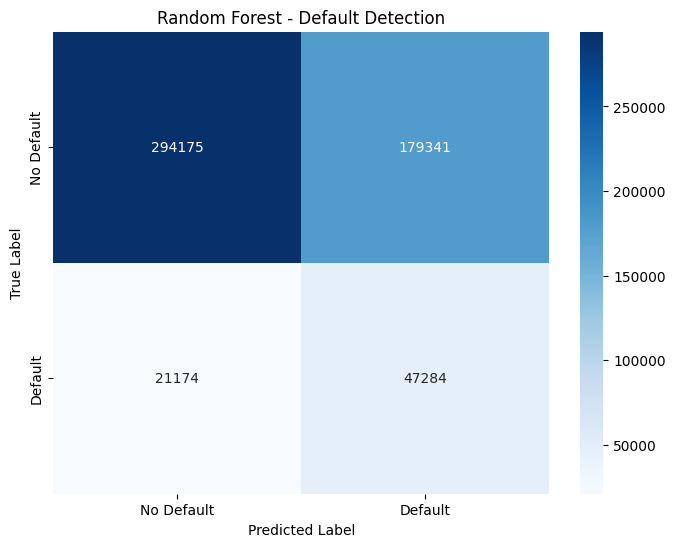

Feature Importance


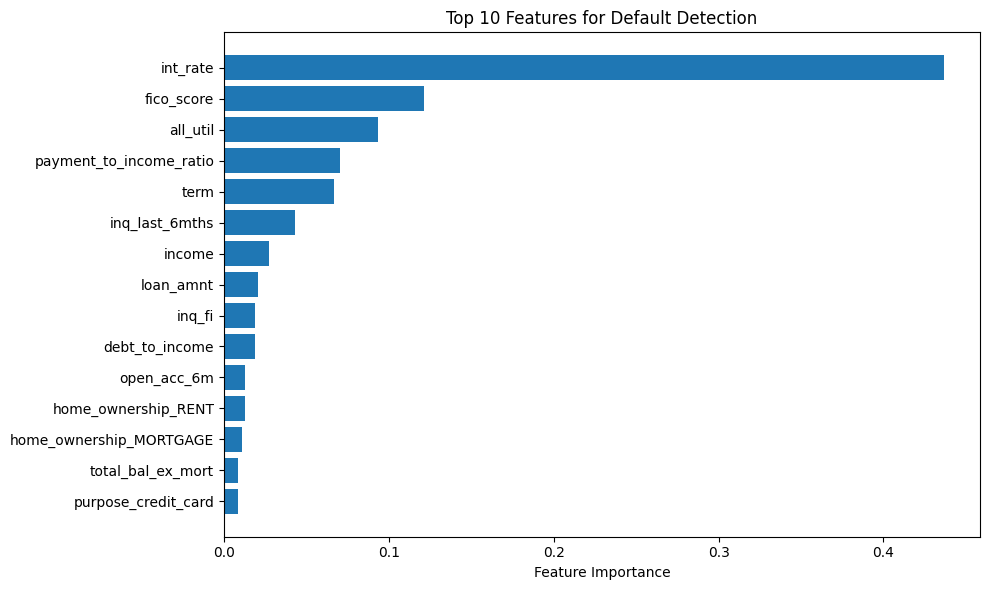

Model Summary
 MODEL PERFORMANCE:
   Overall Accuracy: 63.0%
   ROC AUC: 0.7162
   Default Recall: 69.1%
   Default Precision: 20.9%

 BUSINESS INTERPRETATION:
   → This model catches 69.1% of actual defaults
   → It's good at identifying risky borrowers
   → Overall accuracy is reasonable at 63.0%

 FEATURE INSIGHTS:
   → int_rate is the most important predictor
   → fico_score is the second most important
   → These features drive default prediction most strongly


In [48]:
# Simple Random Forest for Default Detection
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt
import seaborn as sns

print("=== RANDOM FOREST FOR DEFAULT DETECTION ===\n")

# Create and train Random Forest
print("Training Random Forest...")

# Model 
rf_model = RandomForestClassifier(
    random_state=42,
    n_estimators=100,        # Number of trees
    max_depth=10,            # Control tree depth
    class_weight='balanced'  # Handle class imbalance
)
print()

# Train Model
rf_model.fit(X_train, y_train)
print("Training complete")
print()

# Make Predictions
print("Making predictions...")
y_pred = rf_model.predict(X_test)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]  # Probability of default
print("Predictions complete")
print()

# Basic Model Evaluation
print("Model Evaluation")
print()

# Calculate Key Metrics
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_proba)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print(f"Accuracy: {accuracy:.4f}")
print(f"ROC AUC: {roc_auc:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
# Classification Report
print(f"\nClassification Report:")
print(classification_report(y_test, y_pred))


# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate recall for default = 1
tn, fp, fn, tp = cm.ravel()
recall_defaults = tp / (tp + fn) if (tp + fn) > 0 else 0
precision_defaults = tp / (tp + fp) if (tp + fp) > 0 else 0

print(f"\nKey Metrics for Default Detection:")
print(f"Default Recall: {recall_defaults:.4f} (catches {recall_defaults:.1%} of defaults)")
print(f"Default Precision: {precision_defaults:.4f}")

# Confusion Matrix Visualization
print("Confusion Matrix Visualization")

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['No Default', 'Default'],
            yticklabels=['No Default', 'Default'])
plt.title('Random Forest - Default Detection')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Feature Importance
print("Feature Importance")

# Feature Names
train_feature_names = X_train.columns.tolist()

# Top 10 Features
importance_scores = rf_model.feature_importances_

# Create feature importance DataFrame with correct feature names
feature_importance = pd.DataFrame({
    'feature': train_feature_names,
    'importance': importance_scores
}).sort_values('importance', ascending=False)

# Bar Plot of Top 15 Features
plt.figure(figsize=(10, 6))
top_features = feature_importance.head(15)
plt.barh(range(len(top_features)), top_features['importance'])
plt.yticks(range(len(top_features)), top_features['feature'])
plt.xlabel('Feature Importance')
plt.title('Top 10 Features for Default Detection')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()


# Summary and Interpretation
print("Model Summary")

print(" MODEL PERFORMANCE:")
print(f"   Overall Accuracy: {accuracy:.1%}")
print(f"   ROC AUC: {roc_auc:.4f}")
print(f"   Default Recall: {recall_defaults:.1%}")
print(f"   Default Precision: {precision_defaults:.1%}")

print(f"\n BUSINESS INTERPRETATION:")
print(f"   → This model catches {recall_defaults:.1%} of actual defaults")
print(f"   → It's good at identifying risky borrowers")
print(f"   → Overall accuracy is reasonable at {accuracy:.1%}")

print(f"\n FEATURE INSIGHTS:")
if len(feature_importance) > 0:
    print(f"   → {feature_importance.iloc[0]['feature']} is the most important predictor")
    if len(feature_importance) > 1:
        print(f"   → {feature_importance.iloc[1]['feature']} is the second most important")
    print(f"   → These features drive default prediction most strongly")

